# Data Preparation for Differential Gene Expression (DE) and ML and DE analysis

This library contains: 

1. Loading the data and creating a combined DF with all data samples from Cancer and corresponding normal tissue.
2. Creating the input data frames required by PyDESeq2 to perform the Differential expression DE analyis:

      -A count matrix of shape ‘number of samples’ x ‘number of genes’, containing read counts (non-negative integers),

      -Metadata (or annotations, or “column” data) of shape ‘number of samples’ x ‘number of variables’, containing sample annotations that will be used to split the data in cohorts.

3. Perform gene DE anaylsis using pyDeseq2
4. Exploration and visualization of the DE results 
5. Filtering the most differentially expressed genes for further anaylsis by ML
5. Create the data frames with the shorlisted genes, gene expression data and outcomes for using as input for machine learning 

In [2]:
#load packages and libraries
# install needed packages from the terminal in the activated Deep-learning enviroment
#installed  pip install pydeseq2 
#!pip install plotly
#!pip install seaborn
#!pip install tensorflow
# numeric library

import pandas as pd
import os
import numpy as np
from time import time as timer
import tarfile


# file libraries
import pickle as pkl
from typing import Tuple
from typing import Union

# libraries used for DE gene analyis

from pydeseq2.default_inference import DefaultInference
from pydeseq2.ds import DeseqStats
from pydeseq2 import preprocessing 
from pydeseq2.dds import DeseqDataSet



# ML libraries
import sklearn
from sklearn import linear_model
from sklearn import tree
from sklearn import ensemble
from sklearn.preprocessing import StandardScaler 
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.datasets import make_blobs
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.inspection import permutation_importance
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.model_selection import cross_val_score
from sklearn.metrics import roc_curve, roc_auc_score
import tensorflow as tf

# common visualization module
import matplotlib.pyplot as plt
from matplotlib import pyplot as plt
import plotly.express as px
import seaborn as sns
sns.set()

#%matplotlib inline 
from matplotlib import animation
from IPython.display import HTML





2024-06-13 10:03:06.090972: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [3]:
# Create and output pass to save all results

# Replace this with the path to directory where you would like results to be saved
OUTPUT_PATH = "DataMiner-main/PRAD/pyDeseq2_output"
os.makedirs(OUTPUT_PATH, exist_ok=True)  # Create path if it doesn't exist


# 1.  Loading the data and creating a combined DF with all  data samples from Prostate Cancer and their corresponding normal tissue 

In [72]:
#to check if I can open the single files
file_path ="DataMiner-main/PRAD/Primary_Tumor/0a9f83f1-86f9-4153-b8cf-07e8bcb18efb.rna_seq.augmented_star_gene_counts.tsv"
df1 = pd.read_csv(file_path,sep='\t',skiprows=[0])

num_columns = len(df1.columns)
print("Number of columns:", num_columns)
column_names = df1.columns.tolist()  # Convert column names to a list
print("Column names:", column_names)
print('')
print('Example of reads i sigle file:', file_path)
df1

Number of columns: 9
Column names: ['gene_id', 'gene_name', 'gene_type', 'unstranded', 'stranded_first', 'stranded_second', 'tpm_unstranded', 'fpkm_unstranded', 'fpkm_uq_unstranded']

Example of reads i sigle file: DataMiner-main/PRAD/Primary_Tumor/0a9f83f1-86f9-4153-b8cf-07e8bcb18efb.rna_seq.augmented_star_gene_counts.tsv


,gene_id,gene_name,gene_type,unstranded,stranded_first,stranded_second,tpm_unstranded,fpkm_unstranded,fpkm_uq_unstranded
0,N_unmapped,NaN,NaN,4285467,4285467,4285467,NaN,NaN,NaN
1,N_multimapping,NaN,NaN,4257920,4257920,4257920,NaN,NaN,NaN
2,N_noFeature,NaN,NaN,2685016,24317042,24406998,NaN,NaN,NaN
3,N_ambiguous,NaN,NaN,4873766,1156082,1156051,NaN,NaN,NaN
4,ENSG00000000003.15,TSPAN6,protein_coding,2051,1054,997,36.7048,11.2893,11.1675
...,...,...,...,...,...,...,...,...,...
60659,ENSG00000288669.1,AC008763.4,protein_coding,0,0,0,0.0000,0.0000,0.0000
60660,ENSG00000288670.1,AL592295.6,lncRNA,225,119,113,10.1078,3.1088,3.0753
60661,ENSG00000288671.1,AC006486.3,protein_coding,0,0,0,0.0000,0.0000,0.0000
60662,ENSG00000288674.1,AL391628.1,protein_coding,4,2,2,0.0338,0.0104,0.0103


In [ ]:
# Do not need to re-run: Files are saved locally the first time running this code.
# Collect all samples in a single csv file for each cancer and condition.

#use the diferent folders by selecting the files:

folder_path = "DataMiner-main/PRAD/Solid_Tissue_Normal"
#folder_path = "DataMiner-main/PRAD/Primary_Tumor"

combined_data = None  # Initialize the DataFrame to None

for file in os.listdir(folder_path):
    if file.endswith(".tsv"):
        file_path = os.path.join(folder_path, file)
        # Load the TSV file
        df = pd.read_csv(file_path, sep='\t', skiprows=[0])
        df_common_colums = df[['gene_id','gene_name', 'gene_type']]
        # Check if both 'gene_id' and 'unstranded' columns exist in the DataFrame
        if 'gene_id' in df.columns and 'unstranded' in df.columns:
            # Rename the 'unstranded' column to include the file name
            df.rename(columns={'unstranded': f'unstranded_{file}'}, inplace=True)
            
            # Extract the specific columns from the DataFrame
            specific_columns = df[['gene_id', f'unstranded_{file}']]
            
            if combined_data is None:
                # Initialize combined_data with columns from the first DataFrame
                combined_data = specific_columns.copy()
            else:
                # Merge the columns into the combined data DataFrame based on 'gene_id'
                combined_data = pd.merge(combined_data, specific_columns, on='gene_id', how='outer')
        else:
            print(f"Required columns not found in file: {file}")

# Write the combined data to a new CSV file if there's data
#if combined_data is not None:
 #   combined_data.to_csv("combined_data_with_gene_names.csv", index=False)
#else:
   # print("No data to write.")

if combined_data is not None:
    combined_data = pd.merge(combined_data, df_common_colums, on='gene_id', how='outer')
    file_name = f"combined_data_{os.path.basename(folder_path)}.csv"
    combined_data.to_csv(os.path.join(folder_path, file_name), index=False)


else:
    print("No data to write.")
    

# a csv file with the combined data is saved with the name: combined_data_"name of the folder" in the same folder were the data was stored

# Merged generated tables of gene counts (cancer and normal tissue) for prostate cancer (PRAD)

In [73]:
# merged tables of tumor and normal samples for each type of tumor into one table. 
# PRAT Data: get the stored combined files for each condition:

folder_path_1 = "DataMiner-main/PRAD/Solid_Tissue_Normal/combined_data_Solid_Tissue_Normal.csv"
folder_path_2 = "DataMiner-main/PRAD/Primary_Tumor/combined_data_Primary_Tumor.csv"

#Open the combined data:

Primary_Tumor_PRAD = pd.read_csv(folder_path_2)
Solid_Tissue_Normal_PRAD =pd.read_csv(folder_path_1)

 # create a df with gene id,gene type and gene name to use later
Gene_info_df= Primary_Tumor_PRAD[['gene_id','gene_name', 'gene_type']].copy()
# drop the first 4 rows, general info:
Gene_info_df =Gene_info_df.iloc[4:]


# Drop gene name and gen type columns 307a and 308 contain the gene type and gene name for later analyis remove them for the gene expression analyis

    
columns_to_drop = ['gene_name', 'gene_type']
Primary_Tumor_PRAD.drop(columns=columns_to_drop, inplace=True)
Primary_Tumor_PRAD

Solid_Tissue_Normal_PRAD.drop(columns=columns_to_drop, inplace=True)
Solid_Tissue_Normal_PRAD


# Create the counts df for pyDEseq2
# merged both data frames

PRAD_merged_counts_df = pd.merge(Primary_Tumor_PRAD,Solid_Tissue_Normal_PRAD, on= 'gene_id')

Gene_info_df

/var/folders/07/cmbl5t2576sckxlm_hl6tw1c0000gn/T/ipykernel_91103/3096526961.py:8: DtypeWarning:

Columns (307,308) have mixed types. Specify dtype option on import or set low_memory=False.



,gene_id,gene_name,gene_type
4,ENSG00000000003.15,TSPAN6,protein_coding
5,ENSG00000000005.6,TNMD,protein_coding
6,ENSG00000000419.13,DPM1,protein_coding
7,ENSG00000000457.14,SCYL3,protein_coding
8,ENSG00000000460.17,C1orf112,protein_coding
...,...,...,...
60659,ENSG00000288669.1,NaN,NaN
60660,ENSG00000288670.1,NaN,NaN
60661,ENSG00000288671.1,NaN,NaN
60662,ENSG00000288674.1,NaN,NaN


In [74]:
PRAD_merged_counts_df

,gene_id,unstranded_2fa8c89c-893e-465a-aeb5-e3fb81a200c7.rna_seq.augmented_star_gene_counts.tsv,unstranded_288d2dc8-9fb3-4164-8e6a-cee107d11404.rna_seq.augmented_star_gene_counts.tsv,unstranded_7b97885a-f365-4f11-8f35-9bf17a7344b5.rna_seq.augmented_star_gene_counts.tsv,unstranded_e32fc401-5ddd-4dfc-8be4-8d4072a080c3.rna_seq.augmented_star_gene_counts.tsv,unstranded_16eca87b-206a-4c2d-8ab7-f8c2fdb51b0e.rna_seq.augmented_star_gene_counts.tsv,unstranded_328247b9-0404-48e2-8ee7-2c3afc12af6b.rna_seq.augmented_star_gene_counts.tsv,unstranded_87b68e89-fab0-431d-a99b-04468de6a4a8.rna_seq.augmented_star_gene_counts.tsv,unstranded_c5e68a3a-8343-4021-9efb-16d960f33bca.rna_seq.augmented_star_gene_counts.tsv,unstranded_0d355d6a-83c0-46f0-bfb7-1aff119bb3d7.rna_seq.augmented_star_gene_counts.tsv,...,unstranded_97a3dddc-9e26-4b4e-9eec-e881c3c15c5f.rna_seq.augmented_star_gene_counts.tsv,unstranded_449f289b-d345-4b65-bfe1-ed0aaae0c083.rna_seq.augmented_star_gene_counts.tsv,unstranded_67415aab-0b1b-4b52-bdc7-c1240de53a40.rna_seq.augmented_star_gene_counts.tsv,unstranded_927948e6-ee98-4efc-a1b9-8c066a576bd3.rna_seq.augmented_star_gene_counts.tsv,unstranded_b1becd71-bbed-4a0f-af9c-94b9b2af928b.rna_seq.augmented_star_gene_counts.tsv,unstranded_422d5778-bfe0-4e2f-b254-2a753c777686.rna_seq.augmented_star_gene_counts.tsv,unstranded_60028d9d-c8e5-4c4e-a75c-cc3df6f2eea1.rna_seq.augmented_star_gene_counts.tsv,unstranded_2c022016-756e-4cbf-9baa-dab196b6e715.rna_seq.augmented_star_gene_counts.tsv,unstranded_998581d3-8fdc-4f4a-92cd-d98fc0f910bc.rna_seq.augmented_star_gene_counts.tsv,unstranded_9975ae8f-09f2-4343-9281-cbe13c775dca.rna_seq.augmented_star_gene_counts.tsv
0,N_unmapped,2191714,2707879,2265638,1302137,1637779,902160,2339260,1727979,3116557,...,1617753,1919885,1153662,1463853,1434813,2784950,2667266,1186245,1229212,1349964
1,N_multimapping,5149276,3988459,5203931,6228342,4448399,2464667,7121046,6024062,4113731,...,3640323,5327621,6033205,6288170,6276619,5035775,6185637,5288937,7587703,5000314
2,N_noFeature,3573835,2926995,3591253,5066003,2543238,552402,4141634,3598727,2970406,...,1857856,1639153,2166314,2686115,2020446,2122622,2228282,2502200,1982423,2153232
3,N_ambiguous,6158926,4228900,6253520,5538792,5698832,2481632,6080642,8094849,4809327,...,4987264,6728132,8024666,6985496,5556102,4012293,6784203,6594398,6200826,4163851
4,ENSG00000000003.15,3245,2949,3617,3117,2873,1401,2375,4720,2856,...,3876,2990,5236,3973,1497,865,7666,6343,1582,1267
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60659,ENSG00000288669.1,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,1
60660,ENSG00000288670.1,410,245,249,340,193,101,368,426,296,...,308,435,431,476,355,231,504,575,263,208
60661,ENSG00000288671.1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
60662,ENSG00000288674.1,4,9,8,6,4,0,2,9,8,...,2,4,6,5,9,3,5,9,13,5


In [75]:
# remove the first 4 rows containing the total reads for each sample
PRAD_merged_counts_df = PRAD_merged_counts_df.iloc[4:]
PRAD_merged_counts_df
row_names = PRAD_merged_counts_df.index

# Print the row names
print(row_names)

RangeIndex(start=4, stop=60664, step=1)


In [76]:
# transpose the data frame for pydeseq2 input
PRAD_merged_counts_df= PRAD_merged_counts_df.set_index('gene_id').T


In [77]:
PRAD_merged_counts_df

gene_id,ENSG00000000003.15,ENSG00000000005.6,ENSG00000000419.13,ENSG00000000457.14,ENSG00000000460.17,ENSG00000000938.13,ENSG00000000971.16,ENSG00000001036.14,ENSG00000001084.13,ENSG00000001167.14,...,ENSG00000288661.1,ENSG00000288662.1,ENSG00000288663.1,ENSG00000288665.1,ENSG00000288667.1,ENSG00000288669.1,ENSG00000288670.1,ENSG00000288671.1,ENSG00000288674.1,ENSG00000288675.1
unstranded_2fa8c89c-893e-465a-aeb5-e3fb81a200c7.rna_seq.augmented_star_gene_counts.tsv,3245.0,19.0,1520.0,1014.0,180.0,392.0,1098.0,2660.0,2379.0,1679.0,...,0.0,0.0,10.0,0.0,0.0,0.0,410.0,0.0,4.0,14.0
unstranded_288d2dc8-9fb3-4164-8e6a-cee107d11404.rna_seq.augmented_star_gene_counts.tsv,2949.0,10.0,925.0,619.0,159.0,179.0,986.0,1802.0,1617.0,1740.0,...,0.0,0.0,26.0,0.0,0.0,1.0,245.0,0.0,9.0,21.0
unstranded_7b97885a-f365-4f11-8f35-9bf17a7344b5.rna_seq.augmented_star_gene_counts.tsv,3617.0,2.0,1477.0,1204.0,155.0,151.0,291.0,1887.0,2118.0,2676.0,...,0.0,0.0,42.0,0.0,0.0,0.0,249.0,0.0,8.0,39.0
unstranded_e32fc401-5ddd-4dfc-8be4-8d4072a080c3.rna_seq.augmented_star_gene_counts.tsv,3117.0,5.0,1218.0,1006.0,268.0,164.0,643.0,1590.0,2791.0,3139.0,...,0.0,1.0,26.0,0.0,5.0,0.0,340.0,0.0,6.0,33.0
unstranded_16eca87b-206a-4c2d-8ab7-f8c2fdb51b0e.rna_seq.augmented_star_gene_counts.tsv,2873.0,3.0,2157.0,888.0,232.0,483.0,1809.0,2111.0,2704.0,1894.0,...,0.0,0.0,14.0,0.0,0.0,0.0,193.0,0.0,4.0,15.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
unstranded_422d5778-bfe0-4e2f-b254-2a753c777686.rna_seq.augmented_star_gene_counts.tsv,865.0,257.0,1037.0,527.0,103.0,128.0,978.0,1883.0,1445.0,635.0,...,0.0,0.0,15.0,0.0,0.0,1.0,231.0,0.0,3.0,13.0
unstranded_60028d9d-c8e5-4c4e-a75c-cc3df6f2eea1.rna_seq.augmented_star_gene_counts.tsv,7666.0,49.0,1923.0,1495.0,263.0,118.0,1090.0,1980.0,4764.0,2113.0,...,0.0,0.0,2.0,0.0,2.0,0.0,504.0,0.0,5.0,19.0
unstranded_2c022016-756e-4cbf-9baa-dab196b6e715.rna_seq.augmented_star_gene_counts.tsv,6343.0,24.0,2178.0,1625.0,287.0,555.0,5295.0,1919.0,6066.0,2238.0,...,0.0,0.0,5.0,0.0,0.0,0.0,575.0,0.0,9.0,16.0
unstranded_998581d3-8fdc-4f4a-92cd-d98fc0f910bc.rna_seq.augmented_star_gene_counts.tsv,1582.0,503.0,1451.0,745.0,150.0,101.0,1501.0,3682.0,2491.0,734.0,...,0.0,0.0,17.0,0.0,0.0,0.0,263.0,0.0,13.0,11.0


In [ ]:

# Save the DataFrame to a CSV file
PRAD_merged_counts_df.to_csv(os.path.join(OUTPUT_PATH, 'PRAD_merged_counts_df.csv'))

PRAD_merged_counts_df

In [ ]:
# when needed can be called:

PRAD_merged_counts_df = pd.read_csv('DataMiner-main/PRAD/pyDeseq2_output/PRAD_merged_counts_df.csv',index_col=0)
PRAD_merged_counts_df

# The merged counts data frames are use for preparing  the data for DE analysis and ML 



In [ ]:
print(PRAD_merged_counts_df.columns)
print(PRAD_merged_counts_df.index)

# 2. Create: Counts DF and Metadata DF for input for pyDEseq2

# Counts DF for pyDeseq2: filter genes with very low expression (low counts)

In [78]:
# filter the counts df and remove genes that had expression lower than 10 counts in all samples.
# we can set different filters here...but in principle remove the genes with almost no expressio across all samples.
# without filter:60660 genes, with this filter is reduced to: 51956



# Convert all values in the DataFrame to numeric
PRAD_merged_counts_df = PRAD_merged_counts_df.apply(pd.to_numeric, errors='coerce')

# Filter the columns based on the sum condition
genes_to_keep = PRAD_merged_counts_df.columns[PRAD_merged_counts_df.sum(axis=0) >= 10]


# Select only the columns that meet the condition
PRAD_counts_filtered_df = PRAD_merged_counts_df[genes_to_keep]


print(PRAD_counts_filtered_df.columns)

print(f' number of filtered genes= {len(PRAD_merged_counts_df.columns) - len(genes_to_keep)}')

PRAD_counts_filtered_df



Index(['ENSG00000000003.15', 'ENSG00000000005.6', 'ENSG00000000419.13',
       'ENSG00000000457.14', 'ENSG00000000460.17', 'ENSG00000000938.13',
       'ENSG00000000971.16', 'ENSG00000001036.14', 'ENSG00000001084.13',
       'ENSG00000001167.14',
       ...
       'ENSG00000288658.1', 'ENSG00000288659.1', 'ENSG00000288660.1',
       'ENSG00000288662.1', 'ENSG00000288663.1', 'ENSG00000288667.1',
       'ENSG00000288669.1', 'ENSG00000288670.1', 'ENSG00000288674.1',
       'ENSG00000288675.1'],
      dtype='object', name='gene_id', length=51956)
 number of filtered genes= 8704


gene_id,ENSG00000000003.15,ENSG00000000005.6,ENSG00000000419.13,ENSG00000000457.14,ENSG00000000460.17,ENSG00000000938.13,ENSG00000000971.16,ENSG00000001036.14,ENSG00000001084.13,ENSG00000001167.14,...,ENSG00000288658.1,ENSG00000288659.1,ENSG00000288660.1,ENSG00000288662.1,ENSG00000288663.1,ENSG00000288667.1,ENSG00000288669.1,ENSG00000288670.1,ENSG00000288674.1,ENSG00000288675.1
unstranded_2fa8c89c-893e-465a-aeb5-e3fb81a200c7.rna_seq.augmented_star_gene_counts.tsv,3245.0,19.0,1520.0,1014.0,180.0,392.0,1098.0,2660.0,2379.0,1679.0,...,0.0,0.0,0.0,0.0,10.0,0.0,0.0,410.0,4.0,14.0
unstranded_288d2dc8-9fb3-4164-8e6a-cee107d11404.rna_seq.augmented_star_gene_counts.tsv,2949.0,10.0,925.0,619.0,159.0,179.0,986.0,1802.0,1617.0,1740.0,...,2.0,0.0,0.0,0.0,26.0,0.0,1.0,245.0,9.0,21.0
unstranded_7b97885a-f365-4f11-8f35-9bf17a7344b5.rna_seq.augmented_star_gene_counts.tsv,3617.0,2.0,1477.0,1204.0,155.0,151.0,291.0,1887.0,2118.0,2676.0,...,1.0,0.0,2.0,0.0,42.0,0.0,0.0,249.0,8.0,39.0
unstranded_e32fc401-5ddd-4dfc-8be4-8d4072a080c3.rna_seq.augmented_star_gene_counts.tsv,3117.0,5.0,1218.0,1006.0,268.0,164.0,643.0,1590.0,2791.0,3139.0,...,8.0,2.0,0.0,1.0,26.0,5.0,0.0,340.0,6.0,33.0
unstranded_16eca87b-206a-4c2d-8ab7-f8c2fdb51b0e.rna_seq.augmented_star_gene_counts.tsv,2873.0,3.0,2157.0,888.0,232.0,483.0,1809.0,2111.0,2704.0,1894.0,...,1.0,0.0,3.0,0.0,14.0,0.0,0.0,193.0,4.0,15.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
unstranded_422d5778-bfe0-4e2f-b254-2a753c777686.rna_seq.augmented_star_gene_counts.tsv,865.0,257.0,1037.0,527.0,103.0,128.0,978.0,1883.0,1445.0,635.0,...,126.0,0.0,0.0,0.0,15.0,0.0,1.0,231.0,3.0,13.0
unstranded_60028d9d-c8e5-4c4e-a75c-cc3df6f2eea1.rna_seq.augmented_star_gene_counts.tsv,7666.0,49.0,1923.0,1495.0,263.0,118.0,1090.0,1980.0,4764.0,2113.0,...,0.0,0.0,0.0,0.0,2.0,2.0,0.0,504.0,5.0,19.0
unstranded_2c022016-756e-4cbf-9baa-dab196b6e715.rna_seq.augmented_star_gene_counts.tsv,6343.0,24.0,2178.0,1625.0,287.0,555.0,5295.0,1919.0,6066.0,2238.0,...,4.0,0.0,0.0,0.0,5.0,0.0,0.0,575.0,9.0,16.0
unstranded_998581d3-8fdc-4f4a-92cd-d98fc0f910bc.rna_seq.augmented_star_gene_counts.tsv,1582.0,503.0,1451.0,745.0,150.0,101.0,1501.0,3682.0,2491.0,734.0,...,281.0,4.0,0.0,0.0,17.0,0.0,0.0,263.0,13.0,11.0


# Metadata data frame for pyDeseq2

In [79]:
# create metadata dataframe
# It should have the form:row names = sample names, column=condition


# Create metadata for tumor samples:

Primary_Tumor_PRAD= Primary_Tumor_PRAD.iloc[4:]# remove rows with total counts

Primary_Tumor_PRAD_T =Primary_Tumor_PRAD.set_index('gene_id').T

Primary_Tumor_PRAD_T 


# Select the index labels
sample_ID_T = Primary_Tumor_PRAD_T.index

# Create a new DataFrame with the index labels
metadata_PRAD_tumor_df = pd.DataFrame({'sample_ID': sample_ID_T})


# Add a "Condition" column filled with "PRAD_Primary_Tumor"
metadata_PRAD_tumor_df['Condition'] = 'Primary_Tumor_PRAD'

metadata_PRAD_tumor_df



# Create metadata for normal samples

Solid_Tissue_Normal_PRAD = Solid_Tissue_Normal_PRAD.iloc[4:]

Solid_Tissue_Normal_T = Solid_Tissue_Normal_PRAD.set_index('gene_id').T

Solid_Tissue_Normal_T


# Select the index labels
sample_ID_N = Solid_Tissue_Normal_T.index

# Create a new DataFrame with the index labels
metadata_PRAD_Normal_df = pd.DataFrame({'sample_ID': sample_ID_N})


# Add a "Condition" column filled with "PRAD_Primary_Tumor"
metadata_PRAD_Normal_df['Condition'] = 'Normal_Tissue_PRAD'

#metadata_PRAD_Normal_df
metadata_PRAD_tumor_df


,sample_ID,Condition
0,unstranded_2fa8c89c-893e-465a-aeb5-e3fb81a200c...,Primary_Tumor_PRAD
1,unstranded_288d2dc8-9fb3-4164-8e6a-cee107d1140...,Primary_Tumor_PRAD
2,unstranded_7b97885a-f365-4f11-8f35-9bf17a7344b...,Primary_Tumor_PRAD
3,unstranded_e32fc401-5ddd-4dfc-8be4-8d4072a080c...,Primary_Tumor_PRAD
4,unstranded_16eca87b-206a-4c2d-8ab7-f8c2fdb51b0...,Primary_Tumor_PRAD
...,...,...
301,unstranded_2ab5ec76-c5d6-46c0-903c-776848afd2c...,Primary_Tumor_PRAD
302,unstranded_2d295107-34e6-4eb1-9942-9a287c5837a...,Primary_Tumor_PRAD
303,unstranded_7e6e77ec-acdb-4498-b556-486ff71efa6...,Primary_Tumor_PRAD
304,unstranded_d20ff0dc-fa83-478a-99f3-30a4d076c5c...,Primary_Tumor_PRAD


In [80]:
 # Concatenate the metadata Data Frames from  normal and tumor samples into one : concatenate vertically 
Metadata_PRAD_df =  pd.concat([metadata_PRAD_tumor_df, metadata_PRAD_Normal_df])

Metadata_PRAD_df


,sample_ID,Condition
0,unstranded_2fa8c89c-893e-465a-aeb5-e3fb81a200c...,Primary_Tumor_PRAD
1,unstranded_288d2dc8-9fb3-4164-8e6a-cee107d1140...,Primary_Tumor_PRAD
2,unstranded_7b97885a-f365-4f11-8f35-9bf17a7344b...,Primary_Tumor_PRAD
3,unstranded_e32fc401-5ddd-4dfc-8be4-8d4072a080c...,Primary_Tumor_PRAD
4,unstranded_16eca87b-206a-4c2d-8ab7-f8c2fdb51b0...,Primary_Tumor_PRAD
...,...,...
47,unstranded_422d5778-bfe0-4e2f-b254-2a753c77768...,Normal_Tissue_PRAD
48,unstranded_60028d9d-c8e5-4c4e-a75c-cc3df6f2eea...,Normal_Tissue_PRAD
49,unstranded_2c022016-756e-4cbf-9baa-dab196b6e71...,Normal_Tissue_PRAD
50,unstranded_998581d3-8fdc-4f4a-92cd-d98fc0f910b...,Normal_Tissue_PRAD


In [ ]:
# We have now the metadata dataframe and the counts data fames labelled:Metadata_PRAD_df and PRAD_counts_filtered_df

# save the files to disk, run this code to save the first time

# Replace this with the path to directory where you would like results to be saved
OUTPUT_PATH = "DataMiner-main/PRAD/pyDeseq2_output"
os.makedirs(OUTPUT_PATH, exist_ok=True)  # Create path if it doesn't exist

Metadata_PRAD_df.to_csv(os.path.join(OUTPUT_PATH, 'Metadata_PRAD_df.csv'),index=False)
PRAD_counts_filtered_df.to_csv(os.path.join(OUTPUT_PATH, 'PRAD_counts_filtered_df.csv'), index=True)

# Filtering Counts DF and metadata DF for samples with Nan values

In [81]:
# Assuming df is your DataFrame
# Check if df contains any NaN values
if  PRAD_counts_filtered_df.isna().any().any():
    print("DataFrame contains NaN values")
else:
    print("DataFrame does not contain NaN values")




DataFrame contains NaN values


In [82]:
# Identify rows with NaN values
nan_rows_index =  PRAD_counts_filtered_df[ PRAD_counts_filtered_df.isna().any(axis=1)].index
print(nan_rows_index)
# Now nan_rows_index contains the index labels of rows with NaN values in PRAD_counts_filtered_df

# remove rows with nan and create a new Df

PRAD_counts_filtered_clean_df = PRAD_counts_filtered_df.drop(nan_rows_index)


# Remove the same rows from the metadata dataframe (samples in the metadata data frame) 
# set index to first column
Metadata_PRAD_df.set_index(Metadata_PRAD_df.columns[0], inplace=True)
Metadata_PRAD_clean_df = Metadata_PRAD_df.drop(nan_rows_index)
print(Metadata_PRAD_clean_df.shape)
print(PRAD_counts_filtered_clean_df.shape)



Index(['unstranded_7e5352c9-edfb-45d1-8c33-82bf5b74c04a.rna_seq.augmented_star_gene_counts.tsv', 'unstranded_6abbf6f9-095a-464b-a239-f69138aaf88f.rna_seq.augmented_star_gene_counts.tsv'], dtype='object')
(356, 1)
(356, 51956)


In [85]:
# run this code first time to save the data:
PRAD_counts_filtered_clean_df.to_csv(os.path.join(OUTPUT_PATH, 'PRAD_counts_filtered_clean_df.csv'), index=True)
Metadata_PRAD_clean_df.to_csv(os.path.join(OUTPUT_PATH, 'Metadata_PRAD_clean_df.csv'),index=True)


gene_id,ENSG00000000003.15,ENSG00000000005.6,ENSG00000000419.13,ENSG00000000457.14,ENSG00000000460.17,ENSG00000000938.13,ENSG00000000971.16,ENSG00000001036.14,ENSG00000001084.13,ENSG00000001167.14,...,ENSG00000288658.1,ENSG00000288659.1,ENSG00000288660.1,ENSG00000288662.1,ENSG00000288663.1,ENSG00000288667.1,ENSG00000288669.1,ENSG00000288670.1,ENSG00000288674.1,ENSG00000288675.1
unstranded_2fa8c89c-893e-465a-aeb5-e3fb81a200c7.rna_seq.augmented_star_gene_counts.tsv,3245.0,19.0,1520.0,1014.0,180.0,392.0,1098.0,2660.0,2379.0,1679.0,...,0.0,0.0,0.0,0.0,10.0,0.0,0.0,410.0,4.0,14.0
unstranded_288d2dc8-9fb3-4164-8e6a-cee107d11404.rna_seq.augmented_star_gene_counts.tsv,2949.0,10.0,925.0,619.0,159.0,179.0,986.0,1802.0,1617.0,1740.0,...,2.0,0.0,0.0,0.0,26.0,0.0,1.0,245.0,9.0,21.0
unstranded_7b97885a-f365-4f11-8f35-9bf17a7344b5.rna_seq.augmented_star_gene_counts.tsv,3617.0,2.0,1477.0,1204.0,155.0,151.0,291.0,1887.0,2118.0,2676.0,...,1.0,0.0,2.0,0.0,42.0,0.0,0.0,249.0,8.0,39.0
unstranded_e32fc401-5ddd-4dfc-8be4-8d4072a080c3.rna_seq.augmented_star_gene_counts.tsv,3117.0,5.0,1218.0,1006.0,268.0,164.0,643.0,1590.0,2791.0,3139.0,...,8.0,2.0,0.0,1.0,26.0,5.0,0.0,340.0,6.0,33.0
unstranded_16eca87b-206a-4c2d-8ab7-f8c2fdb51b0e.rna_seq.augmented_star_gene_counts.tsv,2873.0,3.0,2157.0,888.0,232.0,483.0,1809.0,2111.0,2704.0,1894.0,...,1.0,0.0,3.0,0.0,14.0,0.0,0.0,193.0,4.0,15.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
unstranded_422d5778-bfe0-4e2f-b254-2a753c777686.rna_seq.augmented_star_gene_counts.tsv,865.0,257.0,1037.0,527.0,103.0,128.0,978.0,1883.0,1445.0,635.0,...,126.0,0.0,0.0,0.0,15.0,0.0,1.0,231.0,3.0,13.0
unstranded_60028d9d-c8e5-4c4e-a75c-cc3df6f2eea1.rna_seq.augmented_star_gene_counts.tsv,7666.0,49.0,1923.0,1495.0,263.0,118.0,1090.0,1980.0,4764.0,2113.0,...,0.0,0.0,0.0,0.0,2.0,2.0,0.0,504.0,5.0,19.0
unstranded_2c022016-756e-4cbf-9baa-dab196b6e715.rna_seq.augmented_star_gene_counts.tsv,6343.0,24.0,2178.0,1625.0,287.0,555.0,5295.0,1919.0,6066.0,2238.0,...,4.0,0.0,0.0,0.0,5.0,0.0,0.0,575.0,9.0,16.0
unstranded_998581d3-8fdc-4f4a-92cd-d98fc0f910bc.rna_seq.augmented_star_gene_counts.tsv,1582.0,503.0,1451.0,745.0,150.0,101.0,1501.0,3682.0,2491.0,734.0,...,281.0,4.0,0.0,0.0,17.0,0.0,0.0,263.0,13.0,11.0


In [113]:
PRAD_counts_filtered_clean_df

gene_id,ENSG00000000003.15,ENSG00000000005.6,ENSG00000000419.13,ENSG00000000457.14,ENSG00000000460.17,ENSG00000000938.13,ENSG00000000971.16,ENSG00000001036.14,ENSG00000001084.13,ENSG00000001167.14,...,ENSG00000288658.1,ENSG00000288659.1,ENSG00000288660.1,ENSG00000288662.1,ENSG00000288663.1,ENSG00000288667.1,ENSG00000288669.1,ENSG00000288670.1,ENSG00000288674.1,ENSG00000288675.1
unstranded_2fa8c89c-893e-465a-aeb5-e3fb81a200c7.rna_seq.augmented_star_gene_counts.tsv,3245.0,19.0,1520.0,1014.0,180.0,392.0,1098.0,2660.0,2379.0,1679.0,...,0.0,0.0,0.0,0.0,10.0,0.0,0.0,410.0,4.0,14.0
unstranded_288d2dc8-9fb3-4164-8e6a-cee107d11404.rna_seq.augmented_star_gene_counts.tsv,2949.0,10.0,925.0,619.0,159.0,179.0,986.0,1802.0,1617.0,1740.0,...,2.0,0.0,0.0,0.0,26.0,0.0,1.0,245.0,9.0,21.0
unstranded_7b97885a-f365-4f11-8f35-9bf17a7344b5.rna_seq.augmented_star_gene_counts.tsv,3617.0,2.0,1477.0,1204.0,155.0,151.0,291.0,1887.0,2118.0,2676.0,...,1.0,0.0,2.0,0.0,42.0,0.0,0.0,249.0,8.0,39.0
unstranded_e32fc401-5ddd-4dfc-8be4-8d4072a080c3.rna_seq.augmented_star_gene_counts.tsv,3117.0,5.0,1218.0,1006.0,268.0,164.0,643.0,1590.0,2791.0,3139.0,...,8.0,2.0,0.0,1.0,26.0,5.0,0.0,340.0,6.0,33.0
unstranded_16eca87b-206a-4c2d-8ab7-f8c2fdb51b0e.rna_seq.augmented_star_gene_counts.tsv,2873.0,3.0,2157.0,888.0,232.0,483.0,1809.0,2111.0,2704.0,1894.0,...,1.0,0.0,3.0,0.0,14.0,0.0,0.0,193.0,4.0,15.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
unstranded_422d5778-bfe0-4e2f-b254-2a753c777686.rna_seq.augmented_star_gene_counts.tsv,865.0,257.0,1037.0,527.0,103.0,128.0,978.0,1883.0,1445.0,635.0,...,126.0,0.0,0.0,0.0,15.0,0.0,1.0,231.0,3.0,13.0
unstranded_60028d9d-c8e5-4c4e-a75c-cc3df6f2eea1.rna_seq.augmented_star_gene_counts.tsv,7666.0,49.0,1923.0,1495.0,263.0,118.0,1090.0,1980.0,4764.0,2113.0,...,0.0,0.0,0.0,0.0,2.0,2.0,0.0,504.0,5.0,19.0
unstranded_2c022016-756e-4cbf-9baa-dab196b6e715.rna_seq.augmented_star_gene_counts.tsv,6343.0,24.0,2178.0,1625.0,287.0,555.0,5295.0,1919.0,6066.0,2238.0,...,4.0,0.0,0.0,0.0,5.0,0.0,0.0,575.0,9.0,16.0
unstranded_998581d3-8fdc-4f4a-92cd-d98fc0f910bc.rna_seq.augmented_star_gene_counts.tsv,1582.0,503.0,1451.0,745.0,150.0,101.0,1501.0,3682.0,2491.0,734.0,...,281.0,4.0,0.0,0.0,17.0,0.0,0.0,263.0,13.0,11.0


In [114]:
Metadata_PRAD_clean_df

,Condition
sample_ID,
unstranded_2fa8c89c-893e-465a-aeb5-e3fb81a200c7.rna_seq.augmented_star_gene_counts.tsv,Primary_Tumor_PRAD
unstranded_288d2dc8-9fb3-4164-8e6a-cee107d11404.rna_seq.augmented_star_gene_counts.tsv,Primary_Tumor_PRAD
unstranded_7b97885a-f365-4f11-8f35-9bf17a7344b5.rna_seq.augmented_star_gene_counts.tsv,Primary_Tumor_PRAD
unstranded_e32fc401-5ddd-4dfc-8be4-8d4072a080c3.rna_seq.augmented_star_gene_counts.tsv,Primary_Tumor_PRAD
unstranded_16eca87b-206a-4c2d-8ab7-f8c2fdb51b0e.rna_seq.augmented_star_gene_counts.tsv,Primary_Tumor_PRAD
...,...
unstranded_422d5778-bfe0-4e2f-b254-2a753c777686.rna_seq.augmented_star_gene_counts.tsv,Normal_Tissue_PRAD
unstranded_60028d9d-c8e5-4c4e-a75c-cc3df6f2eea1.rna_seq.augmented_star_gene_counts.tsv,Normal_Tissue_PRAD
unstranded_2c022016-756e-4cbf-9baa-dab196b6e715.rna_seq.augmented_star_gene_counts.tsv,Normal_Tissue_PRAD


# 3. Differential expression analysis using the  pyDEseq2 package

In [115]:
# See pyDeseq2 documentation and tutorials: https://pydeseq2.readthedocs.io/en/latest/

# Read counts modeling with the DeseqDataSet class

# We start by creating a DeseqDataSet object from the count and metadata data that were just loaded.

inference = DefaultInference(n_cpus=8)
dds = DeseqDataSet(
    counts=PRAD_counts_filtered_clean_df,
    metadata=Metadata_PRAD_clean_df,
    design_factors="Condition",
    refit_cooks=True,
    inference=inference,
)

/Users/paula/opt/anaconda3/envs/Env-Dep-learning/lib/python3.10/site-packages/pydeseq2/dds.py:250: UserWarning:

Some factor levels in the design contain underscores ('_').
                    They will be converted to hyphens ('-').



In [116]:
dds.deseq2()

Fitting size factors...
... done in 0.93 seconds.

Fitting dispersions...
... done in 42.51 seconds.

Fitting dispersion trend curve...
... done in 2.73 seconds.

Fitting MAP dispersions...
... done in 48.43 seconds.

Fitting LFCs...
... done in 23.92 seconds.

Refitting 6545 outliers.

Fitting dispersions...
... done in 4.49 seconds.

Fitting MAP dispersions...
... done in 4.90 seconds.

Fitting LFCs...
... done in 3.03 seconds.

/Users/paula/opt/anaconda3/envs/Env-Dep-learning/lib/python3.10/site-packages/pydeseq2/dds.py:1019: ImplicitModificationWarning:

Setting element `.varm['_normed_means']` of view, initializing view as actual.

/Users/paula/opt/anaconda3/envs/Env-Dep-learning/lib/python3.10/site-packages/pydeseq2/dds.py:1022: ImplicitModificationWarning:

Setting element `.varm['LFC']` of view, initializing view as actual.



In [117]:
print(dds)

AnnData object with n_obs × n_vars = 356 × 51956
    obs: 'Condition'
    uns: 'trend_coeffs', '_squared_logres', 'prior_disp_var'
    obsm: 'design_matrix', 'size_factors', 'replaceable'
    varm: 'non_zero', '_MoM_dispersions', 'genewise_dispersions', '_genewise_converged', '_normed_means', 'fitted_dispersions', 'MAP_dispersions', '_MAP_converged', 'dispersions', '_outlier_genes', 'LFC', '_LFC_converged', 'replaced'
    layers: 'normed_counts', '_mu_hat', '_mu_LFC', '_hat_diagonals', 'cooks', 'replace_cooks'


In [118]:
# save the dds

#with open(os.path.join(OUTPUT_PATH, "dds.pkl"), "wb") as f:
 #   pkl.dump(dds, f)

# can be open again    
with open(os.path.join(OUTPUT_PATH, "dds.pkl"), "rb") as f:
    dds2 = pkl.load(f)

print(dds2)

AnnData object with n_obs × n_vars = 356 × 51956
    obs: 'Condition'
    uns: 'trend_coeffs', '_squared_logres', 'prior_disp_var'
    obsm: 'design_matrix', 'size_factors', 'replaceable'
    varm: 'non_zero', '_MoM_dispersions', 'genewise_dispersions', '_genewise_converged', '_normed_means', 'fitted_dispersions', 'MAP_dispersions', '_MAP_converged', 'dispersions', '_outlier_genes', 'LFC', '_LFC_converged', 'replaced'
    layers: 'normed_counts', '_mu_hat', '_mu_LFC', '_hat_diagonals', 'cooks', 'replace_cooks'


In [119]:
# we can access different things such us:
print(dds.varm["dispersions"])
# acces counts
print(dds.layers["normed_counts"])
print(dds.varm["LFC"])

[0.13729089 2.15986643 0.04143446 ... 0.08237883 0.26908169 0.3120908 ]
[[2.72764202e+03 1.59707853e+01 1.27766283e+03 ... 3.44632736e+02
  3.36227059e+00 1.17679471e+01]
 [3.45816188e+03 1.17265577e+01 1.08470659e+03 ... 2.87300665e+02
  1.05539020e+01 2.46257712e+01]
 [2.88886004e+03 1.59737906e+00 1.17966444e+03 ... 1.98873693e+02
  6.38951625e+00 3.11488917e+01]
 ...
 [4.22161779e+03 1.59733292e+01 1.44957962e+03 ... 3.82694345e+02
  5.98999844e+00 1.06488861e+01]
 [1.57810827e+03 5.01762617e+02 1.44743053e+03 ... 2.62353018e+02
  1.29680199e+01 1.09729399e+01]
 [1.64894011e+03 3.12348560e+02 1.36912786e+03 ... 2.70702085e+02
  6.50726167e+00 1.69188803e+01]]
                    intercept  \
gene_id                         
ENSG00000000003.15   8.185255   
ENSG00000000005.6    4.842968   
ENSG00000000419.13   7.273340   
ENSG00000000457.14   6.758820   
ENSG00000000460.17   5.206043   
...                       ...   
ENSG00000288667.1   -1.618581   
ENSG00000288669.1   -1.541657  

In [120]:
# Statistical analysis with the DeseqStats class.
#Now that dispersions and LFCs were fitted, we may proceed with statistical tests to compute p-values and adjusted p-values for differential expresion.
#This is the role of the DeseqStats class.

stat_res = DeseqStats(dds,inference=inference)
#PyDESeq2 computes p-values using Wald tests. 
#This can be done using the summary() method, which runs the whole statistical analysis, cooks filtering and multiple testing adjustement included.

stat_res.summary()


Running Wald tests...
... done in 6.29 seconds.



Log2 fold change & Wald test p-value: Condition Primary-Tumor-PRAD vs Normal-Tissue-PRAD
                       baseMean  log2FoldChange     lfcSE       stat  \
gene_id                                                                
ENSG00000000003.15  3335.706899       -0.123783  0.080297  -1.541568   
ENSG00000000005.6     30.197803       -3.221012  0.319472 -10.082304   
ENSG00000000419.13  1377.271973       -0.077316  0.044415  -1.740738   
ENSG00000000457.14   823.547162       -0.076069  0.062807  -1.211149   
ENSG00000000460.17   177.066627       -0.049628  0.070122  -0.707744   
...                         ...             ...       ...        ...   
ENSG00000288667.1      0.326720        0.600740  0.956261   0.628217   
ENSG00000288669.1      0.081420        0.011927  1.316544   0.009059   
ENSG00000288670.1    293.707593       -0.257065  0.063193  -4.067948   
ENSG00000288674.1      6.028666        0.101024  0.141648   0.713205   
ENSG00000288675.1     33.699975        0.969440

In [ ]:
#The results are then stored in the results_df attribute (stat_res.results_df). 
# we save the results as a csv file

stat_res.results_df.to_csv(os.path.join(OUTPUT_PATH,'DE_Genes_PRAD.csv'))


In [ ]:
stat_res.plot_MA(log=True, save_path=None)

In [88]:
# open the DE genes and explore wich genes are more differentially expressed to make cut offs.

DE_Genes_PRAD = pd.read_csv('DataMiner-main/PRAD/pyDeseq2_output/DE_Genes_PRAD.csv')
DE_Genes_PRAD 

# merged with one of the original data frames to add gene name and gene type columns
#Gene_info_df

DE_Genes_PRAD_Gene_names = pd.merge(DE_Genes_PRAD, Gene_info_df, on= 'gene_id')

DE_Genes_PRAD_Gene_names

# Explanation of log2FoldChange value:
# log2FoldChange & Wald test p-value: Condition Primary-Tumor-PRAD vs Normal-Tissue-PRAD
# positive log2FoldChange: up-regulated in Tumours compared to normal tissue
# negative log2FoldChange: down-regulated in tumors compared to normal tissue

,gene_id,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj,gene_name,gene_type
0,ENSG00000000003.15,3335.706899,-0.123783,0.080297,-1.541568,1.231786e-01,1.899741e-01,TSPAN6,protein_coding
1,ENSG00000000005.6,30.197803,-3.221012,0.319472,-10.082304,6.615613e-24,3.540108e-22,TNMD,protein_coding
2,ENSG00000000419.13,1377.271973,-0.077316,0.044415,-1.740738,8.172947e-02,1.339952e-01,DPM1,protein_coding
3,ENSG00000000457.14,823.547162,-0.076069,0.062807,-1.211149,2.258384e-01,3.145029e-01,SCYL3,protein_coding
4,ENSG00000000460.17,177.066627,-0.049628,0.070122,-0.707744,4.791040e-01,5.736930e-01,C1orf112,protein_coding
...,...,...,...,...,...,...,...,...,...
51951,ENSG00000288667.1,0.326720,0.600740,0.956261,0.628217,5.298617e-01,6.191116e-01,NaN,NaN
51952,ENSG00000288669.1,0.081420,0.011927,1.316544,0.009059,9.927718e-01,NaN,NaN,NaN
51953,ENSG00000288670.1,293.707593,-0.257065,0.063193,-4.067948,4.742893e-05,1.640609e-04,NaN,NaN
51954,ENSG00000288674.1,6.028666,0.101024,0.141648,0.713205,4.757190e-01,5.707712e-01,NaN,NaN


# DE table is saved  for further used: filtering, analysis, plotting

as: DE_Genes_PRAD_Gene_names

In [ ]:
# save this DE final table for further analysis and plotting:

DE_Genes_PRAD_Gene_names.to_csv(os.path.join(OUTPUT_PATH, 'DE_Genes_PRAD_Gene_names.csv'), index = False)


In [4]:
# to open the DE table for further analyis, plotting etc, use this code:

DE_Genes_PRAD_Gene_names = pd.read_csv('DataMiner-main/PRAD/pyDeseq2_output/DE_Genes_PRAD_Gene_names.csv')
DE_Genes_PRAD_Gene_names

,gene_id,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj,gene_name,gene_type
0,ENSG00000000003.15,3335.706899,-0.123783,0.080297,-1.541568,1.231786e-01,1.899741e-01,TSPAN6,protein_coding
1,ENSG00000000005.6,30.197803,-3.221012,0.319472,-10.082304,6.615613e-24,3.540108e-22,TNMD,protein_coding
2,ENSG00000000419.13,1377.271973,-0.077316,0.044415,-1.740738,8.172947e-02,1.339952e-01,DPM1,protein_coding
3,ENSG00000000457.14,823.547162,-0.076069,0.062807,-1.211149,2.258384e-01,3.145029e-01,SCYL3,protein_coding
4,ENSG00000000460.17,177.066627,-0.049628,0.070122,-0.707744,4.791040e-01,5.736930e-01,C1orf112,protein_coding
...,...,...,...,...,...,...,...,...,...
51951,ENSG00000288667.1,0.326720,0.600740,0.956261,0.628217,5.298617e-01,6.191116e-01,NaN,NaN
51952,ENSG00000288669.1,0.081420,0.011927,1.316544,0.009059,9.927718e-01,NaN,NaN,NaN
51953,ENSG00000288670.1,293.707593,-0.257065,0.063193,-4.067948,4.742893e-05,1.640609e-04,NaN,NaN
51954,ENSG00000288674.1,6.028666,0.101024,0.141648,0.713205,4.757190e-01,5.707712e-01,NaN,NaN


# 4. Exploratory Analysis / Visualization of Differential expressed Genes from the pyDeseq2 output 

Total genes analyzed (features): 51956
Number of DE genes: 1380
Number of up-regulated genes: 725
Number of down-regulated genes: 655
Number of unchanged genes: 50576


<Axes: xlabel='log2FoldChange', ylabel='log_padj'>

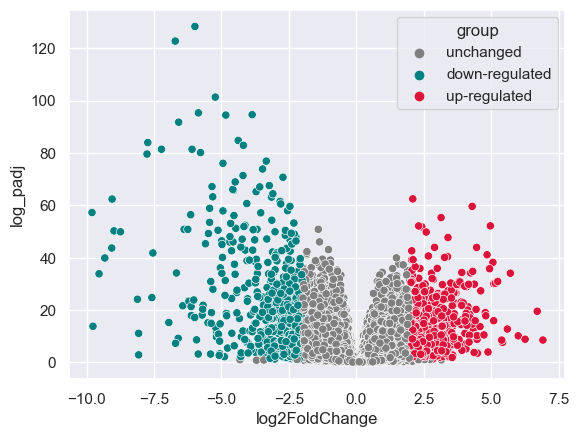

In [5]:
# plot the log 2 folds of the genes
# it is customary to use -log10(adjusted p-value) for the y-axis
# make a copy of the table to adjust for plotting

# Explanation of log2FoldChange value:
# log2FoldChange & Wald test p-value: Condition Primary-Tumor-PRAD vs Normal-Tissue-PRAD
# positive log2FoldChange: up-regulated in Tumours compared to normal tissue
# negative log2FoldChange: down-regulated in tumors compared to normal tissue


df_to_plot = DE_Genes_PRAD_Gene_names.copy()

df_to_plot["log_padj"] = -np.log10(df_to_plot["padj"])

# genes down-regulated in tumors:
up_regulated = df_to_plot.query("log2FoldChange > 2 and padj < 0.05")
#genes up-regulated in tumors:

down_regulated = df_to_plot.query("log2FoldChange < -2 and padj < 0.05")

# make a new column "group" and set it to "unchanged" for all rows
# then fill in the rows that are up- or down-regulated
df_to_plot["group"] = "unchanged"
df_to_plot.loc[up_regulated.index, "group"] = "up-regulated"
df_to_plot.loc[down_regulated.index, "group"] = "down-regulated"


# Count the number of points in each group
num_upregulated = len(up_regulated)
num_downregulated = len(down_regulated)
num_unchanged = len(df_to_plot) - num_upregulated - num_downregulated
Total =num_upregulated+num_downregulated +num_unchanged
num_DE = num_downregulated+num_upregulated 


print("Total genes analyzed (features):" ,Total)
print("Number of DE genes:",num_DE )
print("Number of up-regulated genes:", num_upregulated)
print("Number of down-regulated genes:", num_downregulated)
print("Number of unchanged genes:", num_unchanged)


fig, ax = plt.subplots() 
sns.scatterplot(
    data=df_to_plot,
    x="log2FoldChange",
    y="log_padj",
    hue="group",
    ax=ax, # <- specify the Axes object into which we want to plot
    palette={"up-regulated": "crimson", "down-regulated": "teal", "unchanged": "gray"},
   
)

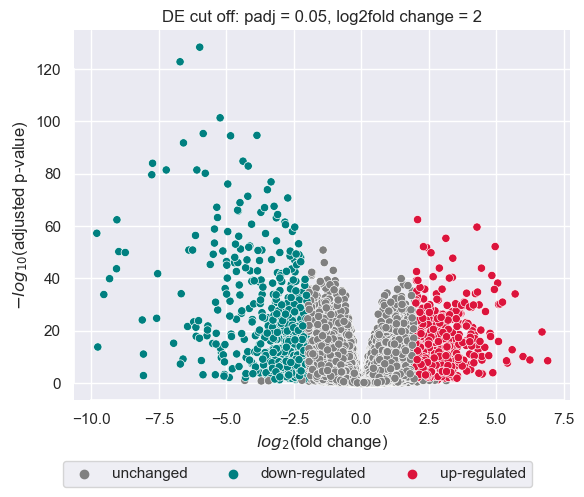

In [6]:
# plotting with legend outside-down

ax.legend(bbox_to_anchor=(0.45, -0.2), loc="center", ncols=3)
sns.despine(fig, trim=True)
ax.set(
    xlabel="$log_2$(fold change)",
    ylabel="$-log_{10}$(adjusted p-value)",
    title="DE cut off: padj = 0.05, log2fold change = 2"
)
fig

In [7]:
# make an interactive plot to check which data point correspond to wich gene

fig = px.scatter(
    data_frame=df_to_plot,
    x="log2FoldChange",
    y="log_padj",
    color="group", # <- color by group, was called "hue" in seaborn
    color_discrete_map={"up-regulated": "crimson", "down-regulated": "teal", "unchanged": "gray"},
    title="Interactive Volcano plot",
    hover_data=["gene_name"], # <- data not used for plotting but that should be included in the hoverinfo
    labels={"log_padj": "-log10(padj)"}
)
fig



In [9]:
# Select the top N upregulated and downregulated genes and make a plot presentation

N= 5

top_upregulated = df_to_plot[df_to_plot['group'] == 'up-regulated'].nlargest(N, 'log2FoldChange')
top_downregulated = df_to_plot[df_to_plot['group'] == 'down-regulated'].nsmallest(N, 'log2FoldChange')
# Combine these top genes into a single DataFrame
top_genes = pd.concat([top_upregulated, top_downregulated])


fig = px.scatter(
    data_frame=df_to_plot,
    x="log2FoldChange",
    y="log_padj",
    color="group", # <- color by group
    color_discrete_map={"up-regulated": "crimson", "down-regulated": "teal", "unchanged": "gray"},
    title="Volcano plot",
    hover_data=["gene_name"], # <- data not used for plotting but that should be included in the hoverinfo
    labels={"log_padj": "-log10(padj)"}
)



# Add annotations for the top genes
for i, row in top_genes.iterrows():
    fig.add_annotation(
        x=row['log2FoldChange'],
        y=row['log_padj'],
        text=row['gene_name'],
        showarrow=True,
        arrowhead=2,
        ax=20,
        ay=-20
    )
    
fig.update_layout(
width=1000,  
height=1000  
)

fig.show()




In [124]:
# save the figure as HTML to import into powerpoint
import plotly.graph_objs as go
import plotly.offline as py

# Export the figure as HTML
py.plot(fig, filename='Volcano_Plot_DE_PRAD.html', auto_open=False)


'Volcano_Plot_DE_PRAD.html'

In [10]:
# Iteractive plot with observed biotypes for each category:

fig2 = px.scatter(
    data_frame=df_to_plot,
    x="log2FoldChange",
    y="gene_type",
    color="group", # <- color by group, was called "hue" in seaborn
    color_discrete_map={"up-regulated": "crimson", "down-regulated": "teal", "unchanged": "gray"},
    title="Biotypes",
    hover_data=["gene_name"] # <- data not used for plotting but that should be included in the hoverinfo
)
fig2


In [128]:
# save the figure as HTML to import into powerpoint
import plotly.graph_objs as go
import plotly.offline as py

# Export the figure as HTML
py.plot(fig2, filename='Biotypes_DE_genes.html', auto_open=False)

'Biotypes_DE_genes.html'

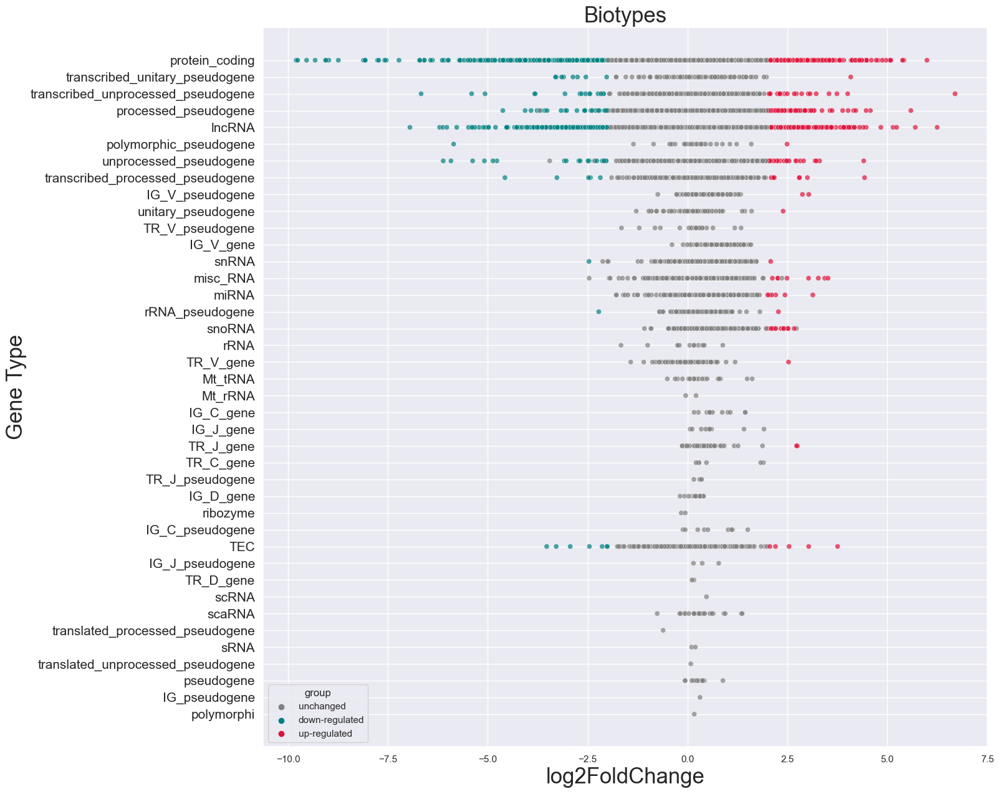

In [11]:
# create a Figure plot of the biotypes

# Create the plot
plt.figure(figsize=(15, 15))
sns.scatterplot(
    data=df_to_plot,
    x="log2FoldChange",
    y="gene_type",
    hue="group",
    palette={"up-regulated": "crimson", "down-regulated": "teal", "unchanged": "gray"},
    legend="full",
    alpha=0.7
)
plt.title("Biotypes", fontsize=25)
plt.xlabel("log2FoldChange", fontsize=25)
plt.ylabel("Gene Type", fontsize=25)
plt.grid(True)

plt.yticks(fontsize=15)
# Show the plot
plt.show()


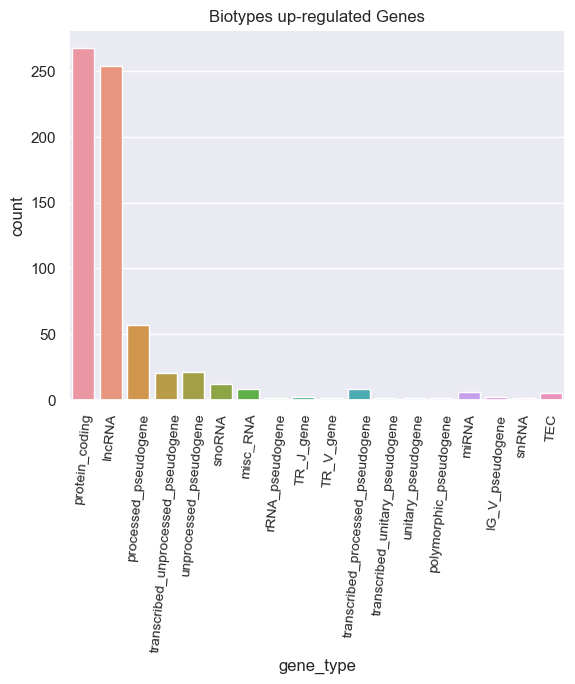

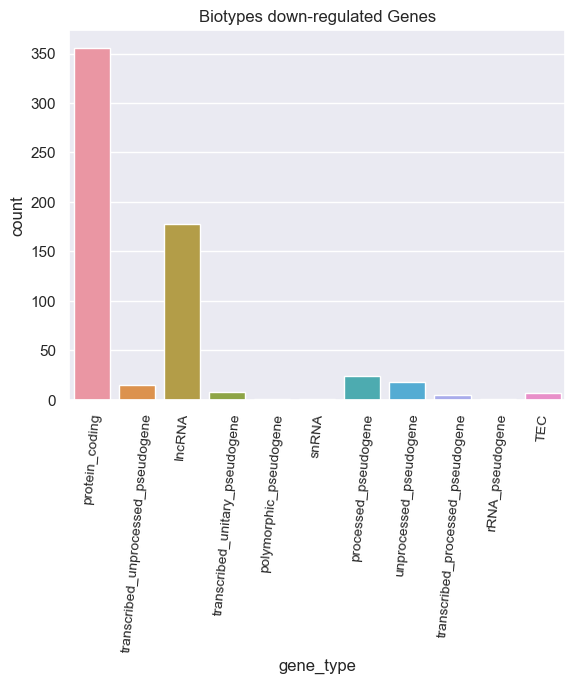

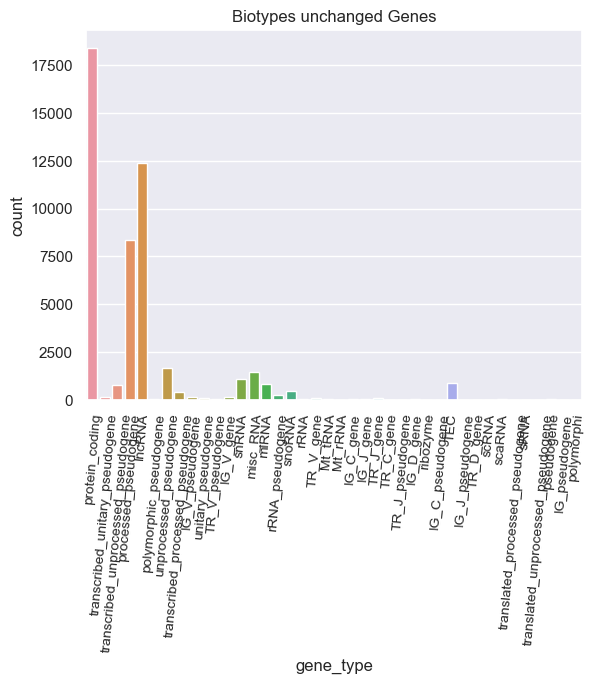

In [64]:
# Plot of the number of genes from each biotype found in up-regulated, down-regulated and unchanged expressed genes

sns.countplot(
    data=df_to_plot[df_to_plot['group'] == 'up-regulated'],
    x='gene_type')
plt.xticks(fontsize = 10, rotation = 85)
plt.title('Biotypes up-regulated Genes')
plt.tight_layout
plt.show()

sns.countplot(
    data=df_to_plot[df_to_plot['group'] == 'down-regulated'],
    x='gene_type')
plt.xticks(fontsize = 10, rotation = 85)
plt.title('Biotypes down-regulated Genes')
plt.tight_layout
plt.show()

sns.countplot(
    data=df_to_plot[df_to_plot['group'] == 'unchanged'],
    x='gene_type')
plt.xticks(fontsize = 10, rotation = 85)
plt.title('Biotypes unchanged Genes')
plt.tight_layout
plt.show()



##### 

# 5. Select most differentially expressed genes for further anaylsis: filtering data by log2FoldChange and and padj to create a gene DE shorlist

In [ ]:
# Funtion to remove all rows were p-val adj is bigger than a certain treshold, and the filter also by a treshold of absolute log2FoldChange
# Here the funtion was the called with a pval_adj_threshold = 0.05 and log2fold_threshold = 2
# the data frame then will contain genes with a padj < 0.05 and a log2FoldChange < -2 or > 2.

def filter_DE_dataframes(df, pval_adj_threshold, log2fold_threshold):
    """
    Filter a DataFrame based on conditions for the "pval" and "log2 fold" columns.

    Parameters:
    - df: pandas DataFrame
        The DataFrame to be filtered.
    - pval_threshold: float
        The threshold value for the "pval" column.
    - log2fold_threshold: float
        The threshold value for the "log2 fold" column.

    Returns:
    - filtered_df: pandas DataFrame
        The filtered DataFrame containing rows where the "pval" column is less than
        the set value and the "log2 fold" column is more than or less than the set value.
    """

    # Filter the DataFrame based on conditions for the "pval" and "log2 fold" columns
    filtered_DE_df = df[(df['padj'] < pval_adj_threshold) & ((df['log2FoldChange'] > log2fold_threshold) | (df['log2FoldChange'] < -log2fold_threshold))]

    return filtered_DE_df

# call the funtion with the disered thresholds of padj and log2FoldChage:

filtered_DE_df =  filter_DE_dataframes(DE_Genes_PRAD_Gene_names,0.05,2)

# there are some missing values in the gene name column-replace them with the gene_id for future use

filtered_DE_df['gene_name'].fillna(filtered_DE_df['gene_id'], inplace=True)
filtered_DE_df

# Replace empty values in "gene name" column with corresponding values from "gene ID" column
empty_mask = filtered_DE_df['gene_name'] == ''
filtered_DE_df.loc[empty_mask, 'gene_name'] =filtered_DE_df.loc[empty_mask, 'gene_id']
filtered_DE_df


                      
# Sort the DataFrame in ascending order based on the values of the specified column
filtered_DE_PRAD_asc = filtered_DE_df.sort_values(by='log2FoldChange', ascending=True)



# Sort the DataFrame in descending order based on the values of the specified column
filtered_DE_PRAD_desc = filtered_DE_df.sort_values(by='log2FoldChange', ascending=False)

#filtered_DE_PRAD_asc for further analysis/plotting
filtered_DE_PRAD_desc.to_csv(os.path.join(OUTPUT_PATH, 'DE_Genes_PRAD_filtered_padj_pval.csv'),index=False)
filtered_DE_PRAD_desc




In [130]:
# filter and save upregulated and downregulated genes in separatelly data frames for GO analyis
DE_Genes_PRAD_filtered_padj_pval = pd.read_csv('DataMiner-main/PRAD/pyDeseq2_output/DE_Genes_PRAD_filtered_padj_pval.csv')

DE_Genes_PRAD_filtered_padj_pval_up = DE_Genes_PRAD_filtered_padj_pval[DE_Genes_PRAD_filtered_padj_pval['log2FoldChange'] > 0 ]
DE_Genes_PRAD_filtered_padj_pval_up


# filter only downregulated genes:

DE_Genes_PRAD_filtered_padj_pval_down = DE_Genes_PRAD_filtered_padj_pval[DE_Genes_PRAD_filtered_padj_pval['log2FoldChange'] < 0 ]
DE_Genes_PRAD_filtered_padj_pval_down

# save data frames for GO analyis in R

DE_Genes_PRAD_filtered_padj_pval_up.to_csv(os.path.join(OUTPUT_PATH, 'DE_Genes_PRAD_filtered_padj_pval_up.csv'),index=False)
DE_Genes_PRAD_filtered_padj_pval_down.to_csv(os.path.join(OUTPUT_PATH, 'DE_Genes_PRAD_filtered_padj_pval_down.csv'),index=False)



In [ ]:
# These data frames were used to make plots GO analysis (with R) and can be used further for pathway analysis,etc


# 6. Creating Normalized Count Tables for Machine Learning on Preselected Genes

In [65]:
# create a matrix like PRAD_merged_counts_df but with gene names and not gene IDs on the colums
# when needed PRAD_merged_counts_df can be load as:

PRAD_merged_counts_df = pd.read_csv('DataMiner-main/PRAD/pyDeseq2_output/PRAD_merged_counts_df.csv',index_col=0)
PRAD_merged_counts_df

,ENSG00000000003.15,ENSG00000000005.6,ENSG00000000419.13,ENSG00000000457.14,ENSG00000000460.17,ENSG00000000938.13,ENSG00000000971.16,ENSG00000001036.14,ENSG00000001084.13,ENSG00000001167.14,...,ENSG00000288661.1,ENSG00000288662.1,ENSG00000288663.1,ENSG00000288665.1,ENSG00000288667.1,ENSG00000288669.1,ENSG00000288670.1,ENSG00000288671.1,ENSG00000288674.1,ENSG00000288675.1
unstranded_2fa8c89c-893e-465a-aeb5-e3fb81a200c7.rna_seq.augmented_star_gene_counts.tsv,3245.0,19.0,1520.0,1014.0,180.0,392.0,1098.0,2660.0,2379.0,1679.0,...,0.0,0.0,10.0,0.0,0.0,0.0,410.0,0.0,4.0,14.0
unstranded_288d2dc8-9fb3-4164-8e6a-cee107d11404.rna_seq.augmented_star_gene_counts.tsv,2949.0,10.0,925.0,619.0,159.0,179.0,986.0,1802.0,1617.0,1740.0,...,0.0,0.0,26.0,0.0,0.0,1.0,245.0,0.0,9.0,21.0
unstranded_7b97885a-f365-4f11-8f35-9bf17a7344b5.rna_seq.augmented_star_gene_counts.tsv,3617.0,2.0,1477.0,1204.0,155.0,151.0,291.0,1887.0,2118.0,2676.0,...,0.0,0.0,42.0,0.0,0.0,0.0,249.0,0.0,8.0,39.0
unstranded_e32fc401-5ddd-4dfc-8be4-8d4072a080c3.rna_seq.augmented_star_gene_counts.tsv,3117.0,5.0,1218.0,1006.0,268.0,164.0,643.0,1590.0,2791.0,3139.0,...,0.0,1.0,26.0,0.0,5.0,0.0,340.0,0.0,6.0,33.0
unstranded_16eca87b-206a-4c2d-8ab7-f8c2fdb51b0e.rna_seq.augmented_star_gene_counts.tsv,2873.0,3.0,2157.0,888.0,232.0,483.0,1809.0,2111.0,2704.0,1894.0,...,0.0,0.0,14.0,0.0,0.0,0.0,193.0,0.0,4.0,15.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
unstranded_422d5778-bfe0-4e2f-b254-2a753c777686.rna_seq.augmented_star_gene_counts.tsv,865.0,257.0,1037.0,527.0,103.0,128.0,978.0,1883.0,1445.0,635.0,...,0.0,0.0,15.0,0.0,0.0,1.0,231.0,0.0,3.0,13.0
unstranded_60028d9d-c8e5-4c4e-a75c-cc3df6f2eea1.rna_seq.augmented_star_gene_counts.tsv,7666.0,49.0,1923.0,1495.0,263.0,118.0,1090.0,1980.0,4764.0,2113.0,...,0.0,0.0,2.0,0.0,2.0,0.0,504.0,0.0,5.0,19.0
unstranded_2c022016-756e-4cbf-9baa-dab196b6e715.rna_seq.augmented_star_gene_counts.tsv,6343.0,24.0,2178.0,1625.0,287.0,555.0,5295.0,1919.0,6066.0,2238.0,...,0.0,0.0,5.0,0.0,0.0,0.0,575.0,0.0,9.0,16.0
unstranded_998581d3-8fdc-4f4a-92cd-d98fc0f910bc.rna_seq.augmented_star_gene_counts.tsv,1582.0,503.0,1451.0,745.0,150.0,101.0,1501.0,3682.0,2491.0,734.0,...,0.0,0.0,17.0,0.0,0.0,0.0,263.0,0.0,13.0,11.0


In [ ]:
# Copy the deseq normalization funtions to get a data frame with normalized counts from the github repository:
#https://github.com/owkin/PyDESeq2/blob/main/pydeseq2/preprocessing.py


def deseq2_norm(
    counts: Union[pd.DataFrame, np.ndarray]
) -> Tuple[Union[pd.DataFrame, np.ndarray], Union[pd.DataFrame, np.ndarray]]:
    """Return normalized counts and size_factors.

    Uses the median of ratios method.

    Parameters
    ----------
    counts : pandas.DataFrame or ndarray
            Raw counts. One column per gene, one row per sample.

    Returns
    -------
    deseq2_counts : pandas.DataFrame or ndarray
        DESeq2 normalized counts.
        One column per gene, rows are indexed by sample barcodes.

    size_factors : pandas.DataFrame or ndarray
        DESeq2 normalization factors.
    """
    logmeans, filtered_genes = deseq2_norm_fit(counts)
    deseq2_counts, size_factors = deseq2_norm_transform(counts, logmeans, filtered_genes)
    return deseq2_counts, size_factors


def deseq2_norm_fit(
    counts: Union[pd.DataFrame, np.ndarray]
) -> Tuple[np.ndarray, np.ndarray]:
    """Return ``logmeans`` and ``filtered_genes``, needed in the median of ratios method.

    ``Logmeans`` and ``filtered_genes`` can then be used to normalize external datasets.

    Parameters
    ----------
    counts : pandas.DataFrame or ndarray
            Raw counts. One column per gene, one row per sample.

    Returns
    -------
    logmeans : ndarray
        Gene-wise mean log counts.

    filtered_genes : ndarray
        Genes whose log means are different from -∞.
    """
    # Compute gene-wise mean log counts
    with np.errstate(divide="ignore"):  # ignore division by zero warnings
        log_counts = np.log(counts)
    logmeans = log_counts.mean(0)
    # Filter out genes with -∞ log means
    filtered_genes = ~np.isinf(logmeans)

    return logmeans, filtered_genes


def deseq2_norm_transform(
    counts: Union[pd.DataFrame, np.ndarray],
    logmeans: np.ndarray,
    filtered_genes: np.ndarray,
) -> Tuple[Union[pd.DataFrame, np.ndarray], Union[pd.DataFrame, np.ndarray]]:
    """Return normalized counts and size factors from the median of ratios method.

    Can be applied on external dataset, using the ``logmeans`` and ``filtered_genes``
    previously computed in the ``fit`` function.

    Parameters
    ----------
    counts : pandas.DataFrame or ndarray
            Raw counts. One column per gene, one row per sample.

    logmeans : ndarray
        Gene-wise mean log counts.

    filtered_genes : ndarray
        Genes whose log means are different from -∞.

    Returns
    -------
    deseq2_counts : pandas.DataFrame or ndarray
        DESeq2 normalized counts.
        One column per gene, rows are indexed by sample barcodes.

    size_factors : pandas.DataFrame or ndarray
        DESeq2 normalization factors.
    """
    with np.errstate(divide="ignore"):  # ignore division by zero warnings
        log_counts = np.log(counts)
    # Subtract filtered log means from log counts
    if isinstance(log_counts, pd.DataFrame):
        log_ratios = log_counts.loc[:, filtered_genes] - logmeans[filtered_genes]
    else:
        log_ratios = log_counts[:, filtered_genes] - logmeans[filtered_genes]
    # Compute sample-wise median of log ratios
    log_medians = np.median(log_ratios, axis=1)
    # Return raw counts divided by size factors (exponential of log ratios)
    # and size factors
    size_factors = np.exp(log_medians)
    deseq2_counts = counts / size_factors[:, None]
    return deseq2_counts, size_factors


In [ ]:
PRAD_merged_counts_df


In [ ]:
# call the deseq2_norm funtion: input must be the non filtered row counts dataframes (the data frame should have all genes, not the filtered df)


deseq2_counts, size_factors = deseq2_norm(PRAD_merged_counts_df)

In [ ]:
deseq2_counts

In [ ]:
filtered_DE_df

In [ ]:
# save the normalized counts for all genes 
deseq2_counts.to_csv(os.path.join(OUTPUT_PATH, 'deseq2_norm_counts_PRAD_all_genes.csv'),index=True) 


In [ ]:
# Create a df only with genes preselected by pval and log2 fold
# filter columns with only the genes present in the DE table.

# Get the list of gene IDs to keep that are DE

genes_DE = filtered_DE_df['gene_id'].tolist()

deseq2_norm_counts_PRAD_DE_genes = deseq2_counts[deseq2_counts.columns.intersection(genes_DE)]

deseq2_norm_counts_PRAD_DE_genes


In [ ]:
# now we need to add the Condition from the meta data file-merge

In [ ]:
print(Metadata_PRAD_clean_df.shape)
print(deseq2_norm_counts_PRAD_DE_genes.shape)


In [ ]:
#drop the samples that had nan in the raw counts original df
deseq2_norm_counts_PRAD_DE_genes_clean = deseq2_norm_counts_PRAD_DE_genes.drop(nan_rows_index)

In [ ]:
print(Metadata_PRAD_clean_df.shape)
print(deseq2_norm_counts_PRAD_DE_genes_clean.shape)

In [ ]:
# Merge the two DataFrames by their index
PRAD_ML_df = pd.merge(Metadata_PRAD_clean_df, deseq2_norm_counts_PRAD_DE_genes_clean, left_index=True, right_index=True)

In [ ]:
PRAD_ML_df

In [ ]:
Output_names = ['Normal Tissue PRAD (0)','Primary Tumor PRAD (1)', ]

# features = genes_DE # im not sure is ok...or we should get it from the colum names of PRAD_ML_df to be sure...and then may be transformed then to gene name using the dictionary or de gene-info df

features = PRAD_ML_df.columns[1:].tolist()

#print(features)
#print(len(features))

# Create a dictionaly of gene_iD and gene_nams from the Gene_info_df

Gene_info_df
# may be move this before

# there are some missing values in the gene name column-replace them with the gene_id for future use

Gene_info_df['gene_name'].fillna(Gene_info_df['gene_id'], inplace=True)
Gene_info_df

# Replace empty values in "gene name" column with corresponding values from "gene ID" column
empty_mask = Gene_info_df['gene_name'] == ''
Gene_info_df.loc[empty_mask, 'gene_name'] =Gene_info_df.loc[empty_mask, 'gene_id']
Gene_info_df

# create a dictionary of gene-id gene-name for later use


# Create a dictionary mapping features to gene names
gene_id_name_dict = dict(zip(Gene_info_df.iloc[:,0],Gene_info_df.iloc[:,1]))


#print(gene_id_name_dict)

# Transform the list of features-gene ids into gene names using the 
features = [gene_id_name_dict.get(feature) for feature in features]

print (features)
print (len(features))


In [ ]:
# change condition names for 0-1 values
# Replace values in the 'class' column
PRAD_ML_df['Condition'] = PRAD_ML_df['Condition'].replace({'Normal_Tissue_PRAD': 0, 'Primary_Tumor_PRAD': 1})

In [ ]:
PRAD_ML_df

In [ ]:
# change the column names by replacing gene ids by gene names
# make first a copy
PRAD_ML_df_gene_names = PRAD_ML_df.copy()

# Get the list of columns to rename (excluding the "condition" column)
columns_to_rename = [col for col in PRAD_ML_df_gene_names.columns if col != "Condition"]

# Rename columns in PRAD_ML_Df using gene_id_name_dict for the columns that are not "condition"
PRAD_ML_df_gene_names.rename(columns={col: gene_id_name_dict.get(col, col) for col in columns_to_rename}, inplace=True)

# Print the DataFrame to verify the changes
PRAD_ML_df_gene_names


# Save the DF to be used for testing different ML 
save as PRAD_ML_df

In [99]:
# save PRAD_ML_df and PRAD_ML_df_gene_names for using in ML algorithms (use one or the other depending if it is desired to have gene names or Ensembl identifier)

PRAD_ML_df.to_csv(os.path.join(OUTPUT_PATH, 'PRAD_ML_df.csv'))

# when needed load again with the code:
PRAD_ML_df = pd.read_csv(os.path.join(OUTPUT_PATH, 'PRAD_ML_df.csv'), index_col=0)
PRAD_ML_df 



,Condition,ENSG00000000005.6,ENSG00000002726.21,ENSG00000004799.8,ENSG00000004838.14,ENSG00000006788.14,ENSG00000007216.15,ENSG00000007264.15,ENSG00000008196.13,ENSG00000009694.13,...,ENSG00000288047.1,ENSG00000288048.1,ENSG00000288060.1,ENSG00000288086.1,ENSG00000288097.1,ENSG00000288101.1,ENSG00000288104.1,ENSG00000288172.1,ENSG00000288547.3,ENSG00000288658.1
unstranded_2fa8c89c-893e-465a-aeb5-e3fb81a200c7.rna_seq.augmented_star_gene_counts.tsv,1,15.966137,865.532686,3723.471197,31.091951,0.840323,0.840323,874.776239,0.000000,715.955193,...,0.000000,35.293566,0.000000,5.041938,0.840323,3.361292,1.680646,0.000000,52.940349,0.000000
unstranded_288d2dc8-9fb3-4164-8e6a-cee107d11404.rna_seq.augmented_star_gene_counts.tsv,1,11.725003,34.002509,1224.090334,69.177519,0.000000,1.172500,315.402586,68.005019,1279.197849,...,0.000000,16.415004,2.345001,8.207502,0.000000,0.000000,5.862502,0.000000,22.277506,2.345001
unstranded_7b97885a-f365-4f11-8f35-9bf17a7344b5.rna_seq.augmented_star_gene_counts.tsv,1,1.597117,251.545950,1652.217685,46.316397,8.784144,3.194234,528.645775,1.597117,177.280003,...,0.000000,0.798559,1.597117,0.000000,0.000000,0.000000,3.194234,0.000000,22.359640,0.798559
unstranded_e32fc401-5ddd-4dfc-8be4-8d4072a080c3.rna_seq.augmented_star_gene_counts.tsv,1,4.584119,51.342133,150.359103,257.627488,2.750471,8.251414,110.935680,8.251414,16160.853136,...,1.833648,6.417767,23.837419,0.000000,0.916824,0.000000,106.351561,0.000000,5.500943,7.334590
unstranded_16eca87b-206a-4c2d-8ab7-f8c2fdb51b0e.rna_seq.augmented_star_gene_counts.tsv,1,2.606933,196.388934,13978.373392,48.662745,0.868978,0.000000,146.857211,2.606933,78.207982,...,0.000000,21.724440,2.606933,0.000000,0.000000,0.000000,4.344888,0.000000,92.980601,0.868978
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
unstranded_422d5778-bfe0-4e2f-b254-2a753c777686.rna_seq.augmented_star_gene_counts.tsv,0,362.026157,85.928388,359838.505069,23.947256,7.043310,8271.663796,30.990566,153.544168,209.890652,...,14.086621,390.199399,0.000000,7.043310,8.451973,0.000000,1.408662,16.903945,2842.680099,177.491423
unstranded_60028d9d-c8e5-4c4e-a75c-cc3df6f2eea1.rna_seq.augmented_star_gene_counts.tsv,0,37.214004,5730.956592,877.946703,26.581431,0.000000,0.759469,30.378779,0.759469,841.492169,...,0.759469,15.948859,0.000000,5.316286,0.000000,0.000000,3.037878,0.000000,12.910981,0.000000
unstranded_2c022016-756e-4cbf-9baa-dab196b6e715.rna_seq.augmented_star_gene_counts.tsv,0,15.963598,27217.934445,12411.697379,17.959048,0.000000,9.312099,67.845291,1.330300,1197.934994,...,1.330300,24.610547,0.000000,9.312099,0.665150,0.665150,0.000000,0.000000,21.949947,2.660600
unstranded_998581d3-8fdc-4f4a-92cd-d98fc0f910bc.rna_seq.augmented_star_gene_counts.tsv,0,501.478180,7.975796,33270.036453,41.872930,0.000000,6171.272232,24.924363,121.630891,56.827547,...,48.851751,447.641556,0.000000,0.996975,26.918312,0.000000,0.996975,8.972771,2408.690422,280.149838


In [13]:
PRAD_ML_df_gene_names.to_csv(os.path.join(OUTPUT_PATH, 'PRAD_ML_df_gene_names.csv'))

# when needed load again with the code:
PRAD_ML_df_gene_names = pd.read_csv(os.path.join(OUTPUT_PATH, 'PRAD_ML_df_gene_names.csv'), index_col=0)
PRAD_ML_df_gene_names 


,Condition,TNMD,AOC1,PDK4,ZMYND10,MYH13,SLC13A2,MATK,TFAP2B,TENM1,...,ENSG00000288047.1,ENSG00000288048.1,ENSG00000288060.1,ENSG00000288086.1,ENSG00000288097.1,ENSG00000288101.1,ENSG00000288104.1,ENSG00000288172.1,ENSG00000288547.3,ENSG00000288658.1
unstranded_2fa8c89c-893e-465a-aeb5-e3fb81a200c7.rna_seq.augmented_star_gene_counts.tsv,1,15.966137,865.532686,3723.471197,31.091951,0.840323,0.840323,874.776239,0.000000,715.955193,...,0.000000,35.293566,0.000000,5.041938,0.840323,3.361292,1.680646,0.000000,52.940349,0.000000
unstranded_288d2dc8-9fb3-4164-8e6a-cee107d11404.rna_seq.augmented_star_gene_counts.tsv,1,11.725003,34.002509,1224.090334,69.177519,0.000000,1.172500,315.402586,68.005019,1279.197849,...,0.000000,16.415004,2.345001,8.207502,0.000000,0.000000,5.862502,0.000000,22.277506,2.345001
unstranded_7b97885a-f365-4f11-8f35-9bf17a7344b5.rna_seq.augmented_star_gene_counts.tsv,1,1.597117,251.545950,1652.217685,46.316397,8.784144,3.194234,528.645775,1.597117,177.280003,...,0.000000,0.798559,1.597117,0.000000,0.000000,0.000000,3.194234,0.000000,22.359640,0.798559
unstranded_e32fc401-5ddd-4dfc-8be4-8d4072a080c3.rna_seq.augmented_star_gene_counts.tsv,1,4.584119,51.342133,150.359103,257.627488,2.750471,8.251414,110.935680,8.251414,16160.853136,...,1.833648,6.417767,23.837419,0.000000,0.916824,0.000000,106.351561,0.000000,5.500943,7.334590
unstranded_16eca87b-206a-4c2d-8ab7-f8c2fdb51b0e.rna_seq.augmented_star_gene_counts.tsv,1,2.606933,196.388934,13978.373392,48.662745,0.868978,0.000000,146.857211,2.606933,78.207982,...,0.000000,21.724440,2.606933,0.000000,0.000000,0.000000,4.344888,0.000000,92.980601,0.868978
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
unstranded_422d5778-bfe0-4e2f-b254-2a753c777686.rna_seq.augmented_star_gene_counts.tsv,0,362.026157,85.928388,359838.505069,23.947256,7.043310,8271.663796,30.990566,153.544168,209.890652,...,14.086621,390.199399,0.000000,7.043310,8.451973,0.000000,1.408662,16.903945,2842.680099,177.491423
unstranded_60028d9d-c8e5-4c4e-a75c-cc3df6f2eea1.rna_seq.augmented_star_gene_counts.tsv,0,37.214004,5730.956592,877.946703,26.581431,0.000000,0.759469,30.378779,0.759469,841.492169,...,0.759469,15.948859,0.000000,5.316286,0.000000,0.000000,3.037878,0.000000,12.910981,0.000000
unstranded_2c022016-756e-4cbf-9baa-dab196b6e715.rna_seq.augmented_star_gene_counts.tsv,0,15.963598,27217.934445,12411.697379,17.959048,0.000000,9.312099,67.845291,1.330300,1197.934994,...,1.330300,24.610547,0.000000,9.312099,0.665150,0.665150,0.000000,0.000000,21.949947,2.660600
unstranded_998581d3-8fdc-4f4a-92cd-d98fc0f910bc.rna_seq.augmented_star_gene_counts.tsv,0,501.478180,7.975796,33270.036453,41.872930,0.000000,6171.272232,24.924363,121.630891,56.827547,...,48.851751,447.641556,0.000000,0.996975,26.918312,0.000000,0.996975,8.972771,2408.690422,280.149838


Prepare validation data from other pages